In [1]:
import matplotlib.pyplot as plt
import numpy as np

from matplotlib.animation import FuncAnimation

plt.rcParams["animation.html"] = "jshtml"

In [2]:
from gravity_ball import GravityBall
from rod import Rod

Animation size has reached 20973000 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


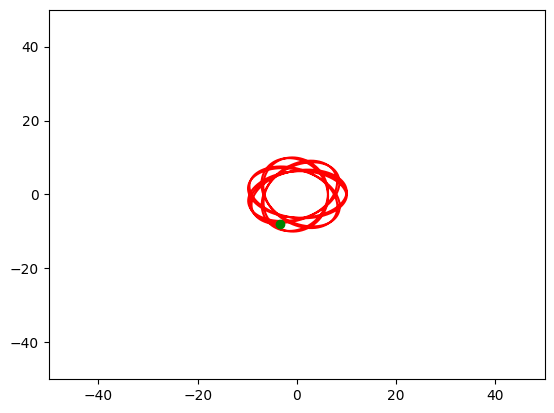

In [24]:
# visualize gravity ball

def animate_ball():
    ball = GravityBall(
        pos=[10, 0],
        d_pos=[-1, 7],
        gravity_center=[0, 0],
        mass=1.0,
        g=10.0
    )

    dt = 0.01

    fig = plt.figure()
    ax = plt.axes(xlim=(-50, 50), ylim=(-50, 50))

    done_dots, = ax.plot([], [], 'r-')
    now_dots, = ax.plot([], [], 'go')
    data_x = []
    data_y = []

    def init():
        done_dots.set_data([], [])
        now_dots.set_data([], [])
        return done_dots, now_dots

    def animate(i):
        x, y = ball.get_position()
        data_x.append(x)
        data_y.append(y)
        ball.step(dt)
        now_dots.set_data([x], [y])
        done_dots.set_data(data_x, data_y)
        return done_dots, now_dots

    return FuncAnimation(fig, animate, init_func=init, frames=5000, interval=dt*1000, blit=True)

animate_ball()

In [135]:
import numpy as np
import scipy.integrate as integrate
from scipy.optimize import brentq

from utils import normalize


class Rod:
    def __init__(self,
                 center_pos=[10, 10],  # pos: x z
                 center_theta=0,
                 d_center_pos=[0, 3],
                 d_center_theta=0,
                 h_floor=0,
                 L=1.0,
                 mass=1.0,
                 inertia=1.0,
                 lamda=0.8,
                 g=9.8):
        self.state = np.array([*center_pos, center_theta, *d_center_pos, d_center_theta])
        self.L = L
        self.mass = mass
        self.inertia = inertia
        self.h_floor = h_floor
        self.g = g
        self.lamda = lamda

    def dstate_dt(self, t, state):
        """derivative of state at time t"""
        return np.array([
            *state[3:5], # d_center_pos
            state[5], # d_center_theta
            0, -self.g, # dd_center_pos
            0  # dd_center_theta
        ])

    def jacobian(self, state):
        """d [pos1, pos2] / d state"""
        theta = state[2]
        return np.array([
            [1, 0, +self.L / 2 * np.sin(theta)],  # pos1 x
            [0, 1, -self.L / 2 * np.cos(theta)],  # pos1 z
            [1, 0, -self.L / 2 * np.sin(theta)],  # pos2 x
            [0, 1, +self.L / 2 * np.cos(theta)]   # pos2 z
        ])

    def get_pos1(self):
        center = self.state[0:2]
        theta = self.state[2]
        return center - self.L / 2 * np.array([np.cos(theta), np.sin(theta)])

    def get_pos2(self):
        center = self.state[0:2]
        theta = self.state[2]
        return center + self.L / 2 * np.array([np.cos(theta), np.sin(theta)])

    def event(self, t, state):
        """a continuous function that its change in sign signals ode to stop progressing"""
        centerz = state[1]
        theta = state[2]
        z1 = centerz - self.L / 2 * np.sin(theta)
        z2 = centerz + self.L / 2 * np.sin(theta)
        return min(z1, z2) - self.h_floor

    def apply_ground_impulse(self):
        # switch
        # governing equations:
        #       M ddq = J^T F_tip    ->  M dq_post - J^T Impulse = M dq
        #       dp_post = -lambda * dp -> J dq_post = -lambda J dq
        #      [[M   -J^T]    [dq_post    =  [ M dq
        #       [J      0]]    Impulse]   =    -lambda J dq ]
        ########
        M = np.array([[self.mass, 0, 0],
                      [0, self.mass, 0],
                      [0, 0, self.inertia]])
        J = self.jacobian(self.state)
        if self.get_pos1()[1] < self.get_pos2()[1]:  ## pos1 lower
            J = np.array([J[1]])
        else:                                                            ## pos2 lower
            J = np.array([J[3]])
        dq = self.state[3:].reshape(3, 1)
        A = np.block([
            [M, -J.T],
            [J, np.zeros((J.shape[0], J.shape[0]))]])
        b = np.block([
            [M @ dq],
            [-self.lamda * J @ dq]
        ])
        inversed = np.linalg.inv(A) @ b
        dq_post = inversed[0:3]
        self.state = np.array([*self.state[0:3], *dq_post.reshape((3,))])

    def step(self, dt):
        if dt <= 1e-9:
            return
        new_state = integrate.odeint(self.dstate_dt, self.state, [0, dt], tfirst=True)[1]
        if (self.event(dt, new_state) > 0) ^ (self.event(dt, self.state) > 0): # change in even
            # for now just ignore finding the exact time of the hit
            self.apply_ground_impulse()
        else:
            self.state = new_state


rod = Rod(
             center_pos=[0, 1],  # pos: x z
             center_theta=1,
             d_center_pos=[0, 0],
             d_center_theta=0,
             h_floor=0,
             L=1.0,
             mass=1.0,
             inertia=0.1,
             lamda=0.5,
             g=9.81)



/tmp/ipykernel_6097/3633387287.py:70: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax2.set_xlim(min(ts), max(ts))
/tmp/ipykernel_6097/3633387287.py:71: UserWarning: Attempting to set identical low and high xlims makes transformation singular; automatically expanding.
  ax3.set_xlim(min(ts), max(ts))
/tmp/ipykernel_6097/3633387287.py:72: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax2.set_ylim(min([x[1] for x in state_history]), max([x[1] for x in state_history]))
/tmp/ipykernel_6097/3633387287.py:73: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax3.set_ylim(min([x[4] for x in state_history]), max([x[4] for x in state_history]))


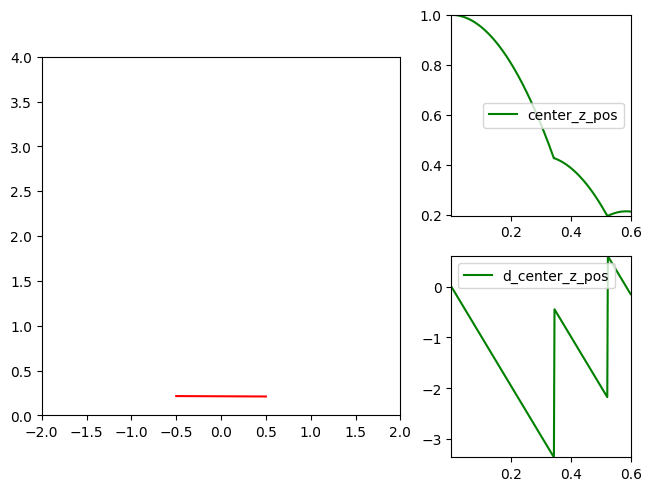

In [138]:
import matplotlib.gridspec as gridspec

# visualize gravity ball

def animate_rod():
#     rod = Rod(
#                  center_pos=[0, 1],  # pos: x z
#                  center_theta=np.pi/4,
#                  d_center_pos=[3, 0],
#                  d_center_theta=0,
#                  h_floor=0,
#                  L=1.0,
#                  mass=1.0,
#                  inertia=3.0,
#                  lamda=1.0,
#                  g=9.8)
    rod = Rod(
                 center_pos=[0, 1],  # pos: x z
                 center_theta=1,
                 d_center_pos=[0, 0],
                 d_center_theta=0,
                 h_floor=0,
                 L=1.0,
                 mass=1.0,
                 inertia=0.1,
                 lamda=0.5,
                 g=9.81)

    dt = 0.002
    duration = 0.6 # seconds
    num_frames = int(duration / dt)

    fig = plt.figure(constrained_layout=True)
    spec = gridspec.GridSpec(nrows=2, ncols=3, figure=fig)
    ax1 = fig.add_subplot(spec[:, :2])
    ax2 = fig.add_subplot(spec[0, 2])
    ax3 = fig.add_subplot(spec[1, 2])


#     fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    ax1.set_xlim(-2, 2)
    ax1.set_box_aspect(1)
    
    ax1.set_ylim(0, 4)
    
    line, = ax1.plot([], [], 'r')
    center_y_line, = ax2.plot([], [], 'g')
    d_center_y_line, = ax3.plot([], [], 'g')
    ax2.legend(['center_z_pos'])
    ax3.legend(['d_center_z_pos'])
    state_history = [] # remove this later. state is being shared
    current_t = 0
    ts = []
    
    def init():
        line.set_data([], [])
        return line, center_y_line, d_center_y_line

    def animate(i):
        nonlocal current_t
        x1, y1 = rod.get_pos1()
        x2, y2 = rod.get_pos2()
        current_t += dt
        ts.append(current_t)
        state_history.append(rod.state)
        rod.step(dt)
        line.set_data([x1, x2], [y1, y2])
        center_y_line.set_data(ts, [state[1] for state in state_history])
        d_center_y_line.set_data(ts, [state[4] for state in state_history])
        ax2.set_xlim(min(ts), max(ts))
        ax3.set_xlim(min(ts), max(ts))
        ax2.set_ylim(min([x[1] for x in state_history]), max([x[1] for x in state_history]))
        ax3.set_ylim(min([x[4] for x in state_history]), max([x[4] for x in state_history]))
        return line, center_y_line, d_center_y_line

    return FuncAnimation(fig, animate, init_func=init, frames=num_frames, interval=dt * 1000, blit=True)

animate_rod()